# CAP 6619 - Deep Learning
## Summer 2021 - Dr Marques
## Final Project
## Action Recognition from Video Sequences

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Summer-2021---Dr-Marques" data-toc-modified-id="Summer-2021---Dr-Marques-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Summer 2021 - Dr Marques</a></span></li><li><span><a href="#Final-Project" data-toc-modified-id="Final-Project-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Final Project</a></span></li><li><span><a href="#Action-Recognition-from-Video-Sequences" data-toc-modified-id="Action-Recognition-from-Video-Sequences-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Action Recognition from Video Sequences</a></span></li><li><span><a href="#Info:" data-toc-modified-id="Info:-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Info:</a></span></li><li><span><a href="#Setup" data-toc-modified-id="Setup-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Setup</a></span></li><li><span><a href="#Using-the-UCF101-dataset" data-toc-modified-id="Using-the-UCF101-dataset-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Using the UCF101 dataset</a></span></li><li><span><a href="#Making-predictions-using-videos-from-other-sources" data-toc-modified-id="Making-predictions-using-videos-from-other-sources-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Making predictions using videos from other sources</a></span></li><li><span><a href="#Building-the-sample-dataset" data-toc-modified-id="Building-the-sample-dataset-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Building the sample dataset</a></span></li><li><span><a href="#Use-Transfer-Learning-to-Predict-videos-from-each-category" data-toc-modified-id="Use-Transfer-Learning-to-Predict-videos-from-each-category-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Use Transfer Learning to Predict videos from each category</a></span></li><li><span><a href="#Statistics-based-on-Group-of-Actions" data-toc-modified-id="Statistics-based-on-Group-of-Actions-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Statistics based on Group of Actions</a></span></li><li><span><a href="#Classification-Report" data-toc-modified-id="Classification-Report-11"><span class="toc-item-num">11&nbsp;&nbsp;</span>Classification Report</a></span></li><li><span><a href="#Confusion-Matrix" data-toc-modified-id="Confusion-Matrix-12"><span class="toc-item-num">12&nbsp;&nbsp;</span>Confusion Matrix</a></span></li></ul></div>

## Info:

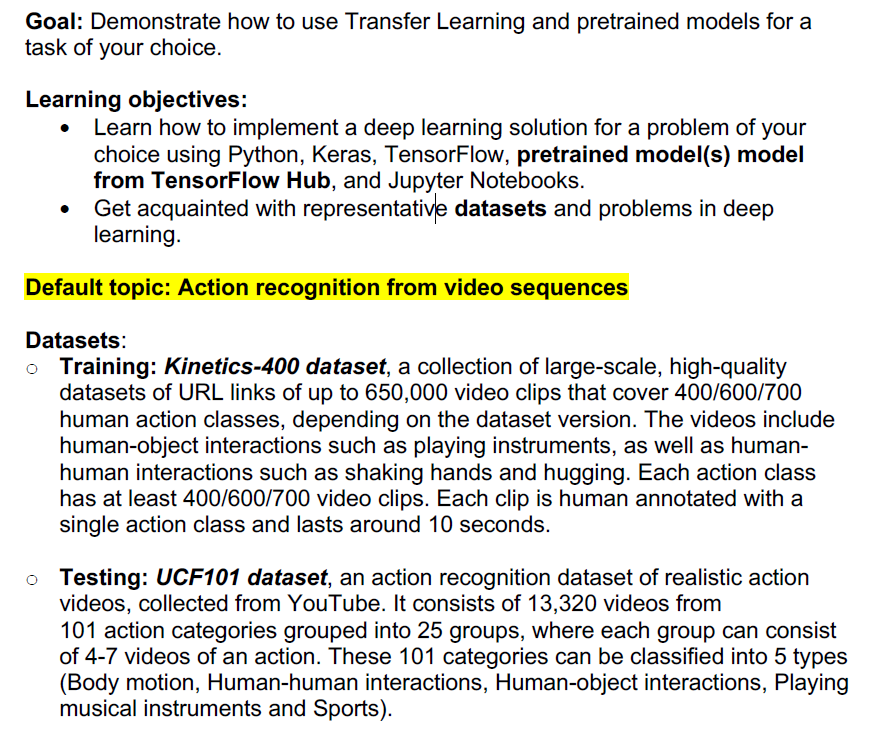

Useful references and sources:

- https://www.tensorflow.org/hub/tutorials/action_recognition_with_tf_hub
- https://www.crcv.ucf.edu/data/UCF101.php 

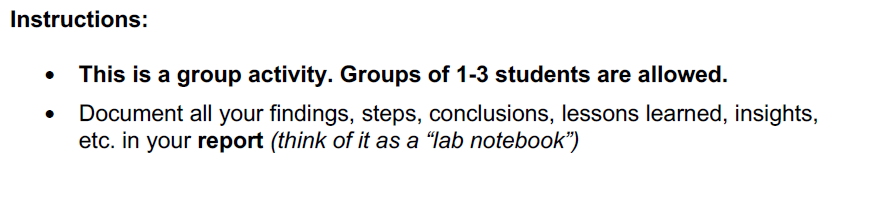

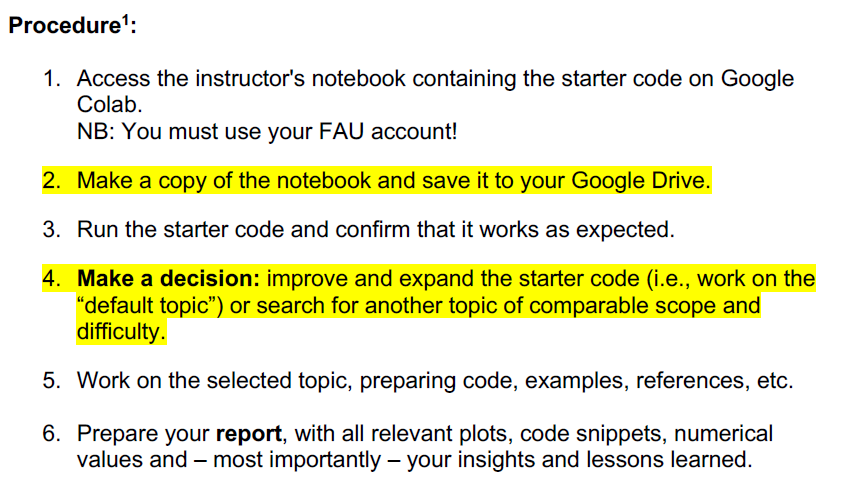

## Setup

In [ ]:
!pip install --upgrade pip
!pip install networkx

In [ ]:
!pip install -q imageio
!pip install -q opencv-python
!pip install -q git+https://github.com/tensorflow/docs

In [ ]:
#@title Import the necessary modules
# TensorFlow and TF-Hub modules.
from absl import logging

import tensorflow as tf
import tensorflow_hub as hub
from tensorflow_docs.vis import embed

logging.set_verbosity(logging.ERROR)

# Some modules to help with reading the UCF101 dataset.
import random
import re
import os
import tempfile
import ssl
import cv2
import numpy as np

# Some modules to display an animation using imageio.
import imageio
from IPython import display

from urllib import request  # requires python3

In [ ]:
#@title Helper functions for the UCF101 dataset

# Utilities to fetch videos from UCF101 dataset
UCF_ROOT = "https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/"
_VIDEO_LIST = None
_CACHE_DIR = tempfile.mkdtemp()
# As of July 2020, crcv.ucf.edu doesn't use a certificate accepted by the
# default Colab environment anymore.
unverified_context = ssl._create_unverified_context()

def list_ucf_videos():
  """Lists videos available in UCF101 dataset."""
  global _VIDEO_LIST
  if not _VIDEO_LIST:
    index = request.urlopen(UCF_ROOT, context=unverified_context).read().decode("utf-8")
    videos = re.findall("(v_[\w_]+\.avi)", index)
    _VIDEO_LIST = sorted(set(videos))
  return list(_VIDEO_LIST)

def fetch_ucf_video(video):
  """Fetchs a video and cache into local filesystem."""
  cache_path = os.path.join(_CACHE_DIR, video)
  if not os.path.exists(cache_path):
    urlpath = request.urljoin(UCF_ROOT, video)
    print("Fetching %s => %s" % (urlpath, cache_path))
    data = request.urlopen(urlpath, context=unverified_context).read()
    open(cache_path, "wb").write(data)
  return cache_path

# Utilities to open video files using CV2
def crop_center_square(frame):
  y, x = frame.shape[0:2]
  min_dim = min(y, x)
  start_x = (x // 2) - (min_dim // 2)
  start_y = (y // 2) - (min_dim // 2)
  return frame[start_y:start_y+min_dim,start_x:start_x+min_dim]

def load_video(path, max_frames=0, resize=(224, 224)):
  cap = cv2.VideoCapture(path)
  frames = []
  try:
    while True:
      ret, frame = cap.read()
      if not ret:
        break
      frame = crop_center_square(frame)
      frame = cv2.resize(frame, resize)
      frame = frame[:, :, [2, 1, 0]]
      frames.append(frame)
      
      if len(frames) == max_frames:
        break
  finally:
    cap.release()
  return np.array(frames) / 255.0

def to_gif(images):
  converted_images = np.clip(images * 255, 0, 255).astype(np.uint8)
  imageio.mimsave('./animation.gif', converted_images, fps=25)
  return embed.embed_file('./animation.gif')

In [ ]:
#@title Get the kinetics-400 labels
# Get the kinetics-400 action labels from the GitHub repository.
KINETICS_URL = "https://raw.githubusercontent.com/deepmind/kinetics-i3d/master/data/label_map.txt"
with request.urlopen(KINETICS_URL) as obj:
  labels = [line.decode("utf-8").strip() for line in obj.readlines()]
print("Found %d labels." % len(labels))

Found 400 labels.


In [ ]:
labels

['abseiling',
 'air drumming',
 'answering questions',
 'applauding',
 'applying cream',
 'archery',
 'arm wrestling',
 'arranging flowers',
 'assembling computer',
 'auctioning',
 'baby waking up',
 'baking cookies',
 'balloon blowing',
 'bandaging',
 'barbequing',
 'bartending',
 'beatboxing',
 'bee keeping',
 'belly dancing',
 'bench pressing',
 'bending back',
 'bending metal',
 'biking through snow',
 'blasting sand',
 'blowing glass',
 'blowing leaves',
 'blowing nose',
 'blowing out candles',
 'bobsledding',
 'bookbinding',
 'bouncing on trampoline',
 'bowling',
 'braiding hair',
 'breading or breadcrumbing',
 'breakdancing',
 'brush painting',
 'brushing hair',
 'brushing teeth',
 'building cabinet',
 'building shed',
 'bungee jumping',
 'busking',
 'canoeing or kayaking',
 'capoeira',
 'carrying baby',
 'cartwheeling',
 'carving pumpkin',
 'catching fish',
 'catching or throwing baseball',
 'catching or throwing frisbee',
 'catching or throwing softball',
 'celebrating',
 'cha

## Using the UCF101 dataset

In [ ]:
# Get the list of videos in the dataset.
ucf_videos = list_ucf_videos()
  
categories = {}
for video in ucf_videos:
  category = video[2:-12]
  if category not in categories:
    categories[category] = []
  categories[category].append(video)
print("Found %d videos in %d categories." % (len(ucf_videos), len(categories)))

for category, sequences in categories.items():
  summary = ", ".join(sequences[:2])
  print("%-20s %4d videos (%s, ...)" % (category, len(sequences), summary))


Found 13320 videos in 101 categories.
ApplyEyeMakeup        145 videos (v_ApplyEyeMakeup_g01_c01.avi, v_ApplyEyeMakeup_g01_c02.avi, ...)
ApplyLipstick         114 videos (v_ApplyLipstick_g01_c01.avi, v_ApplyLipstick_g01_c02.avi, ...)
Archery               145 videos (v_Archery_g01_c01.avi, v_Archery_g01_c02.avi, ...)
BabyCrawling          132 videos (v_BabyCrawling_g01_c01.avi, v_BabyCrawling_g01_c02.avi, ...)
BalanceBeam           108 videos (v_BalanceBeam_g01_c01.avi, v_BalanceBeam_g01_c02.avi, ...)
BandMarching          155 videos (v_BandMarching_g01_c01.avi, v_BandMarching_g01_c02.avi, ...)
BaseballPitch         150 videos (v_BaseballPitch_g01_c01.avi, v_BaseballPitch_g01_c02.avi, ...)
BasketballDunk        131 videos (v_BasketballDunk_g01_c01.avi, v_BasketballDunk_g01_c02.avi, ...)
Basketball            134 videos (v_Basketball_g01_c01.avi, v_Basketball_g01_c02.avi, ...)
BenchPress            160 videos (v_BenchPress_g01_c01.avi, v_BenchPress_g01_c02.avi, ...)
Biking              

In [ ]:
# Get a sample soccer video.
# video_path = fetch_ucf_video("v_SoccerJuggling_g01_c01.avi")

# AH: getting a different example for proper display. New sample surfing waves video
video_path = fetch_ucf_video("v_Surfing_g01_c01.avi")

sample_video = load_video(video_path)

Fetching https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/v_Surfing_g01_c01.avi => /tmp/tmphbfn8cfh/v_Surfing_g01_c01.avi


In [ ]:
sample_video.shape

(254, 224, 224, 3)

In [ ]:
i3d = hub.load("https://tfhub.dev/deepmind/i3d-kinetics-400/1").signatures['default']

Run the id3 model and print the top-5 action predictions.

In [ ]:
def predict(sample_video):
  # Add a batch axis to the to the sample video.
  model_input = tf.constant(sample_video, dtype=tf.float32)[tf.newaxis, ...]

  logits = i3d(model_input)['default'][0]
  probabilities = tf.nn.softmax(logits)

  print("Top 5 actions:")
  for i in np.argsort(probabilities)[::-1][:5]:
    print(f"  {labels[i]:22}: {probabilities[i] * 100:5.2f}%")


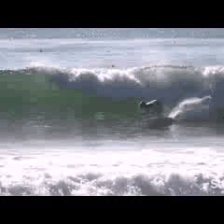

In [ ]:
to_gif(sample_video)

In [ ]:
predict(sample_video)

Top 5 actions:
  surfing water         : 96.96%
  kitesurfing           :  2.19%
  windsurfing           :  0.39%
  faceplanting          :  0.19%
  snowkiting            :  0.12%


In [ ]:
def predict_top_one(sample_video):
  # Add a batch axis to the to the sample video.
  model_input = tf.constant(sample_video, dtype=tf.float32)[tf.newaxis, ...]

  logits = i3d(model_input)['default'][0]
  probabilities = tf.nn.softmax(logits)

  print("Top 1 action:")
  for i in np.argsort(probabilities)[::-1][:1]:
    print(f"  {labels[i]:22}: {probabilities[i] * 100:5.2f}%")

In [ ]:
predict_top_one(sample_video)

Top 1 action:
  surfing water         : 96.96%


## Making predictions using videos from other sources

Now try a new video, from: https://commons.wikimedia.org/wiki/Category:Videos_of_sports

How about [this video](https://commons.wikimedia.org/wiki/File:End_of_a_jam.ogv) by Patrick Gillett: 

In [ ]:
!curl -O https://upload.wikimedia.org/wikipedia/commons/8/86/End_of_a_jam.ogv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 55.0M  100 55.0M    0     0  27.2M      0  0:00:02  0:00:02 --:--:-- 27.2M


In [ ]:
video_path = "End_of_a_jam.ogv"

In [ ]:
sample_video = load_video(video_path)[:100]
sample_video.shape

(100, 224, 224, 3)


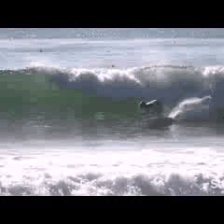

In [ ]:
to_gif(sample_video)

In [ ]:
predict(sample_video)

Top 5 actions:
  surfing water         : 98.76%
  kitesurfing           :  0.75%
  windsurfing           :  0.32%
  faceplanting          :  0.09%
  catching or throwing frisbee:  0.02%


## Building the sample dataset

In [ ]:
# upload validation data here 

In [ ]:
import pandas as pd 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Use Transfer Learning to Predict videos from each category

In [ ]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
import networkx as nx

In [ ]:
# logic to create csv takes to long to run use created csv's will lockup colab run locally on use gpu ram 
# I am looping through 3 videos per category
#if i do it in colab takes to long
# we used a sample of list of ucfs as test data 20 second 
# for i in videos_df.true_label.unique()[54:]:
    
#     for j in videos_df[videos_df.true_label == i].video[:3]:
        
#         video.append(j)
#         true_label.append(j[2:-12])
        
#         pred = predict_video(j)
#         predicted_label.append(labels[np.argsort(pred)[-1]])
#         probability.append(np.max(pred))
        
#         print(i, j, labels[np.argsort(pred)[-1]], np.max(pred))

In [ ]:
# https://docs.google.com/spreadsheets/d/152li7eq2YW8W5383vEle9wNPOcznVG8-/edit?usp=sharing&ouid=113323008452213821236&rtpof=true&sd=true
# share link where i store my validation set 

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


Instructions for successful run below: 
1. download csv from link above
2. mount drive once you get code copy paste into input above and click enter on keyboard it will mount automatically(I fell in love with google colab after doing this once good experience)
3. upload validation_data.xlsx and you can see below in screenshot where its supposed to live and how it looks like(took me 12-14 hours to generate just use csv for validation its a sample of list of videos above)
  - link https://docs.google.com/spreadsheets/d/152li7eq2YW8W5383vEle9wNPOcznVG8-/edit?usp=sharing&ouid=113323008452213821236&rtpof=true&sd=true
4. share link abot to validation data is available if you have a fau email if not you can contact me directly any time 24/7 amahmoo6@fau.edu or 56123672203

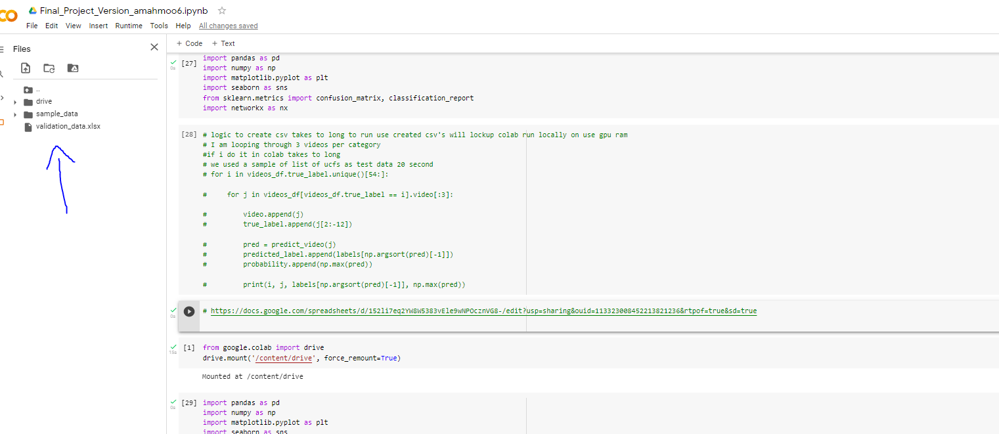

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
import networkx as nx
from IPython.display import display


class FinalProject:
    # refactor local factory architecture
    # init method or constructor
    def __init__(self, ucf_videos):
        self.video = []
        self.true_label = []
        self.predicted_label = []
        self.ucf_videos = ucf_videos
        self.build()

    def build(self):
        self.data_setup()
        self.dataframe_setup()
        self.setup_csv()
        self.setup_colors()
        # Visualize all predictions charts
        # self.visualize_A()
        # self.visualize_B()
        # Statistics values that derived from  Group of Actions
        # self.visualize_c()
        # self.visualize_d()
        # Classification Report
        # self.report_classification_handler()
        # Confusion Matrix Handlers
        # self.confusion_matrix_handler()
        # self.plot_confusion_matrix_handler()
        # self.plot_confusion_matrix_normalized_handler()

    def data_setup(self):
        for i in range(len(self.ucf_videos)):
            self.video.append(self.ucf_videos[i])
            self.true_label.append(self.ucf_videos[i][2:-12])

    def dataframe_setup(self):
        self.videos_df = pd.DataFrame(
            {
                "video": self.video,
                "true_label": self.true_label
            })
        display(self.videos_df)

    def setup_csv(self):
        #csv took 12-14 hrs to create just import 
        self.data = pd.read_excel('validation_data.xlsx')
        display(self.data)
        self.groups = self.data.true_label_group.unique()
        display(self.groups)

    def setup_colors(self):
        self.colors = ['#283d3b', '#197278', '#edddd4', '#c44536', '#772e25']
        self.colors_group = dict(zip(self.groups, self.colors))
        display(self.colors_group)
        self.data['color'] = self.data.true_label_group.str.lower().map(self.colors_group)
        display(self.data)

        ## for statistacal actions
        self.groups2 = ['Human-Object Interaction', 'Body-Motion Only', 'Human-Human Interaction','Playing Musical Instruments', 'Sports']
        self.colors2 = ['#003049', '#d62828', '#f77f00', '#fcbf49', '#eae2b7']
        self.colors_group2 = dict(zip(self.groups2, self.colors2))

    def graph_bar_prob(self, true_label):
        sns.barplot(data=self.data[self.data.true_label == true_label], x='predicted_label', y='probability',
                    palette='Greens',
                    order=self.data[self.data.true_label == true_label].groupby('predicted_label')[
                        'probability'].mean().sort_values(ascending=False).index.values)

    def visualize_A(self):
        index = 0
        plt.figure(figsize=(40, 80))
        for i in range(len(self.data.true_label.unique())):
            name = self.data.true_label.unique()[index]
            index = index + 1
            plt.subplot(21, 6, index)
            G = nx.from_pandas_edgelist(self.data[self.data.true_label == name],
                                        source='true_label',
                                        target='predicted_label',
                                        edge_attr='probability'
                                        )
            elarge = [(u, v) for (u, v, d) in G.edges(data=True) if d["probability"] > 0.9]
            esmall = [(u, v) for (u, v, d) in G.edges(data=True) if d["probability"] <= 0.9]
            pos = nx.spring_layout(G, seed=7)
            nx.draw_networkx_nodes(G, pos, node_size=700)
            # edges
            nx.draw_networkx_edges(G, pos, edgelist=elarge, width=8, alpha=0.8, edge_color='green')
            nx.draw_networkx_edges(
                G, pos, edgelist=esmall, width=3, alpha=0.5, edge_color="b", style="dashed"
            )
            # labels
            nx.draw_networkx_labels(G, pos, font_size=20, font_family="sans-serif")
            plt.title(name)

    def visualize_B(self):
        index = 0
        plt.figure(figsize=(40, 80))
        for i in range(len(self.data.true_label.unique())):
            name = self.data.true_label.unique()[index]
            index = index + 1
            plt.subplot(21, 6, index)
            self.graph_bar_prob(name)
            plt.title(name)
        plt.tight_layout()

    def visualize_c(self):
        self.order = self.data.groupby(['true_label_group', 'color'])[['probability']].count()
        self.order.reset_index(level=1, inplace=True)
        self.color_order2 = self.order.sort_values(by='probability', ascending=False)['color']

        plt.figure(figsize=(10, 5))
        sns.countplot(data=self.data, x='true_label_group',
                      order=self.data.true_label_group.value_counts().index,
                      palette=self.color_order2)
        plt.xticks(rotation=90)
        plt.xlabel("current Grps")
        plt.ylabel("all Count")
        plt.title('Number of Videos Used by cat')
        plt.show()

    def visualize_d(self):
        plt.figure(figsize=(10, 5))
        sns.boxplot(data=self.data, y='probability', x='true_label_group', color='#197278',
                    order=self.data.groupby('true_label_group')['probability'].mean().sort_values(
                        ascending=False).index.values)
        plt.xticks(rotation=90)
        plt.xlabel("Groups_")
        plt.ylabel("Probabilitiues")
        plt.title('Distribution by Cat')
        plt.show()

    def report_classification_handler(self):
        print(classification_report(self.data.true_label_group, self.data.predicted_label_group))

    def confusion_matrix_handler(self):
        self.c_matrix = confusion_matrix(self.data.true_label_group, self.data.predicted_label_group)

    def plot_confusion_matrix_handler(self):
        plt.figure(figsize=(8, 6))
        sns.heatmap(pd.DataFrame(self.c_matrix,
                                 columns=self.data.true_label_group.sort_values().unique(),
                                 index=self.data.true_label_group.sort_values().unique()), annot=True, fmt="d",
                    cmap='Greens')
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        plt.title('Conf Matrix')
        plt.show()

    def plot_confusion_matrix_normalized_handler(self):
        plt.figure(figsize=(8, 6))

        sns.heatmap(pd.DataFrame(self.c_matrix / self.c_matrix.astype(np.float).sum(axis=1),
                                 columns=self.data.true_label_group.sort_values().unique(),
                                 index=self.data.true_label_group.sort_values().unique()), annot=True,
                    cmap='Greens')
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        plt.title('Normalized Conf Matrix')
        plt.show()

    def charts_for_predictions(self):
        #chart dfown predictions 1
        self.visualize_A()
        self.visualize_B()

    def statistics_values_from_actions_grouped_up(self):
        # Statistics values that derived from  Group of Actions 2
        self.visualize_c()
        self.visualize_d()

    def classification_report(self):
        # call for classification reporting 3
        self.report_classification_handler()

    def confusion_matrix_handler_report_main(self):
        # derives conf matrix normalize and non normalized 4 
        self.confusion_matrix_handler()
        self.plot_confusion_matrix_handler()
        self.plot_confusion_matrix_normalized_handler()

    def predict_video(self, sample_video):
        video_path = fetch_ucf_video(sample_video)
        sample_video = load_video(video_path)
        model_input = tf.constant(sample_video, dtype=tf.float32)[tf.newaxis, ...]
        logits = i3d(model_input)['default'][0]
        probabilities = tf.nn.softmax(logits)
        return probabilities


project_object = FinalProject(ucf_videos)

,video,true_label
0,v_ApplyEyeMakeup_g01_c01.avi,ApplyEyeMakeup
1,v_ApplyEyeMakeup_g01_c02.avi,ApplyEyeMakeup
2,v_ApplyEyeMakeup_g01_c03.avi,ApplyEyeMakeup
3,v_ApplyEyeMakeup_g01_c04.avi,ApplyEyeMakeup
4,v_ApplyEyeMakeup_g01_c05.avi,ApplyEyeMakeup
...,...,...
13315,v_YoYo_g25_c01.avi,YoYo
13316,v_YoYo_g25_c02.avi,YoYo
13317,v_YoYo_g25_c03.avi,YoYo
13318,v_YoYo_g25_c04.avi,YoYo


,video,true_label,predicted_label,probability,predicted_label_group,true_label_group
0,v_MoppingFloor_g01_c01.avi,MoppingFloor,sweeping floor,0.574220,human-object interaction,human-object interaction
1,v_MoppingFloor_g01_c02.avi,MoppingFloor,mopping floor,0.478470,human-object interaction,human-object interaction
2,v_MoppingFloor_g01_c03.avi,MoppingFloor,mopping floor,0.705187,human-object interaction,human-object interaction
3,v_Nunchucks_g01_c01.avi,Nunchucks,sword fighting,0.214966,human-object interaction,human-object interaction
4,v_Nunchucks_g01_c02.avi,Nunchucks,sword fighting,0.232423,human-object interaction,human-object interaction
...,...,...,...,...,...,...
298,v_MilitaryParade_g01_c02.avi,MilitaryParade,marching,0.999987,human-human interaction,human-human interaction
299,v_MilitaryParade_g01_c03.avi,MilitaryParade,marching,0.996825,human-human interaction,human-human interaction
300,v_Mixing_g01_c01.avi,Mixing,cleaning toilet,0.270976,human-object interaction,human-object interaction
301,v_Mixing_g01_c02.avi,Mixing,cleaning toilet,0.263049,human-object interaction,human-object interaction


array(['human-object interaction', 'sports',
       'playing musical instruments', 'body-motion only',
       'human-human interaction'], dtype=object)

{'body-motion only': '#c44536',
 'human-human interaction': '#772e25',
 'human-object interaction': '#283d3b',
 'playing musical instruments': '#edddd4',
 'sports': '#197278'}

,video,true_label,predicted_label,probability,predicted_label_group,true_label_group,color
0,v_MoppingFloor_g01_c01.avi,MoppingFloor,sweeping floor,0.574220,human-object interaction,human-object interaction,#283d3b
1,v_MoppingFloor_g01_c02.avi,MoppingFloor,mopping floor,0.478470,human-object interaction,human-object interaction,#283d3b
2,v_MoppingFloor_g01_c03.avi,MoppingFloor,mopping floor,0.705187,human-object interaction,human-object interaction,#283d3b
3,v_Nunchucks_g01_c01.avi,Nunchucks,sword fighting,0.214966,human-object interaction,human-object interaction,#283d3b
4,v_Nunchucks_g01_c02.avi,Nunchucks,sword fighting,0.232423,human-object interaction,human-object interaction,#283d3b
...,...,...,...,...,...,...,...
298,v_MilitaryParade_g01_c02.avi,MilitaryParade,marching,0.999987,human-human interaction,human-human interaction,#772e25
299,v_MilitaryParade_g01_c03.avi,MilitaryParade,marching,0.996825,human-human interaction,human-human interaction,#772e25
300,v_Mixing_g01_c01.avi,Mixing,cleaning toilet,0.270976,human-object interaction,human-object interaction,#283d3b
301,v_Mixing_g01_c02.avi,Mixing,cleaning toilet,0.263049,human-object interaction,human-object interaction,#283d3b


# Charting out the predictions

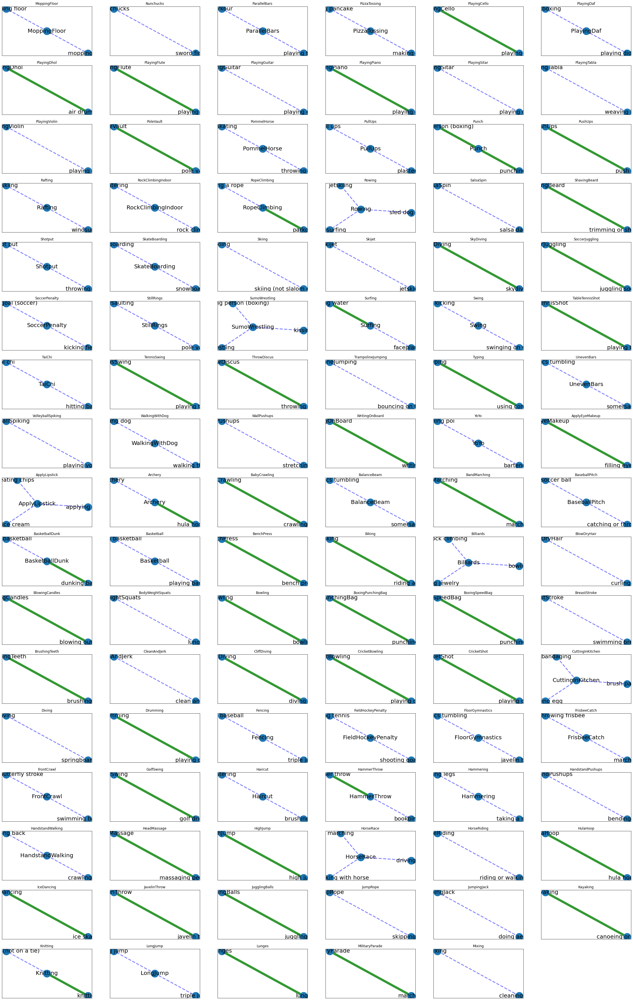

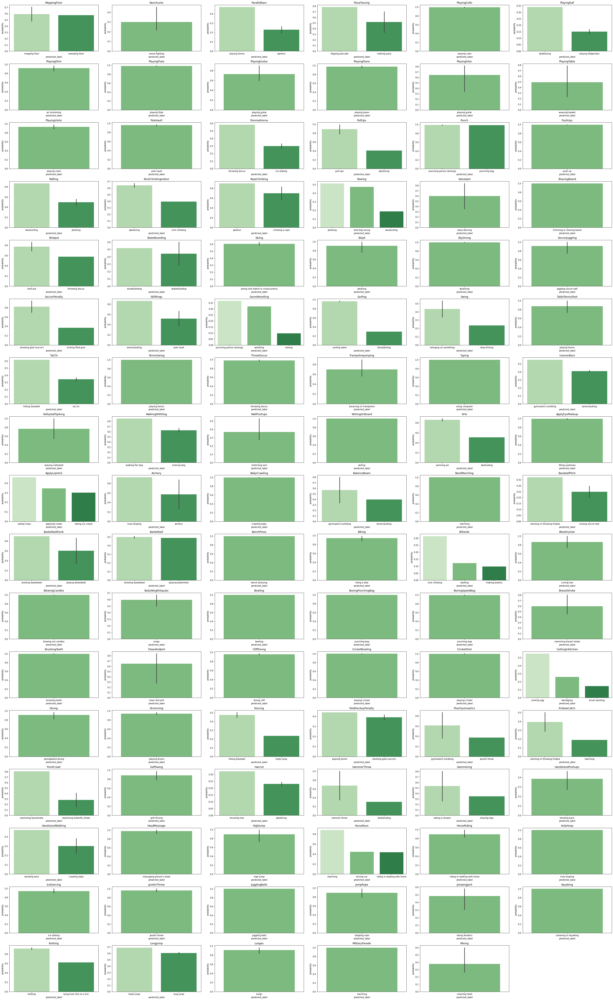

In [ ]:
project_object.charts_for_predictions()

## Statistics derived from Collections of Actions

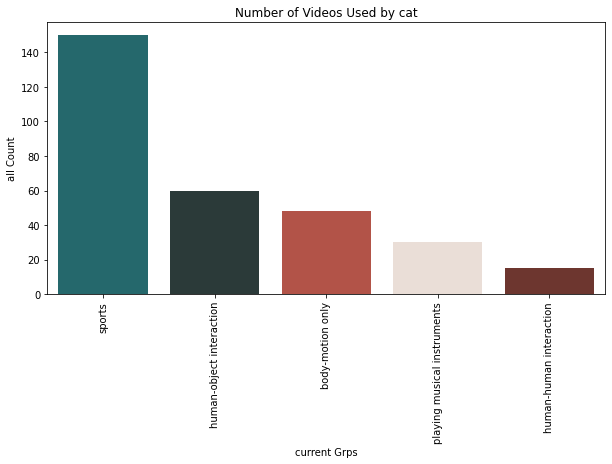

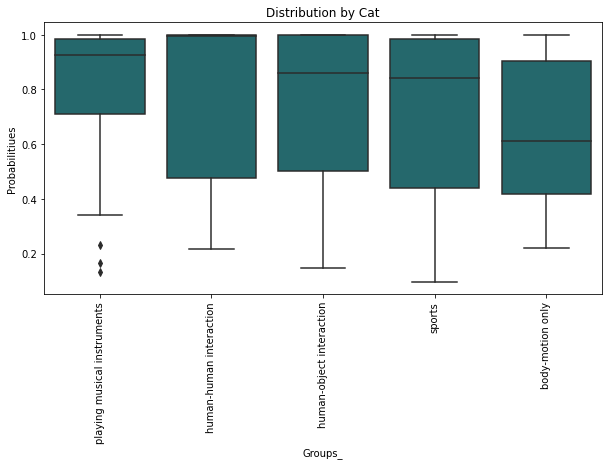

In [ ]:
project_object.statistics_values_from_actions_grouped_up()

## Requirement for Classification Report

In [ ]:
project_object.classification_report()

                             precision    recall  f1-score   support

           body-motion only       0.41      0.42      0.41        48
    human-human interaction       0.64      0.47      0.54        15
   human-object interaction       0.44      0.95      0.60        60
playing musical instruments       1.00      0.77      0.87        30
                     sports       0.99      0.59      0.74       150

                   accuracy                           0.65       303
                  macro avg       0.69      0.64      0.63       303
               weighted avg       0.77      0.65      0.66       303



## Requirement for Confusion Matrix

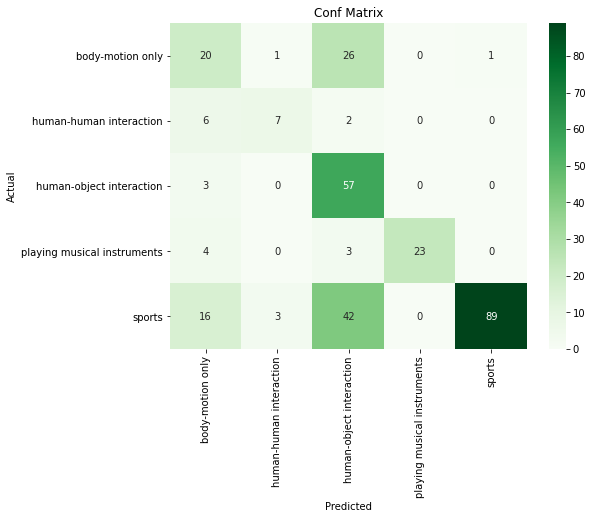

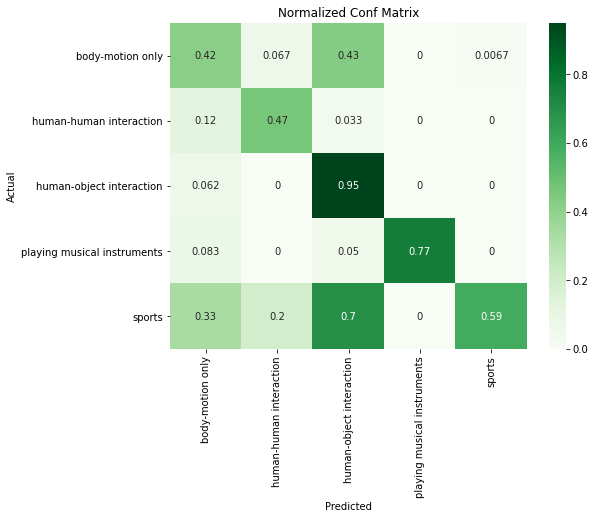

In [ ]:
project_object.confusion_matrix_handler_report_main()